## Configuración
Rellenando cosas importantes

In [1]:
num_landmarks = 11

In [2]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
import math

# Función para verificar si un punto está cercano a alguno de una lista (tolerancia en píxeles)
def is_close(pt, pts, tol=5):
    for p in pts:
        if np.linalg.norm(pt - p) < tol:
            return True
    return False

# Función para mostrar un corte de la imagen

def show_crop(file, image, final_landmarks, crop_width, crop_height):
    imagen_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Calcular el centro de los landmarks
    center_x = int(np.mean(final_landmarks[:, 0]))
    center_y = int(np.mean(final_landmarks[:, 1]))

    # Calcular los límites del recorte
    # Recordar: el eje x corresponde a columnas y el eje y a filas.
    x1 = center_x - crop_width // 2
    x2 = center_x + crop_width // 2
    y1 = center_y - crop_height // 2
    y2 = center_y + crop_height // 2

    # Es recomendable comprobar que los límites estén dentro de la imagen
    h, w = imagen_rgb.shape[:2]
    x1 = max(x1, 0)
    y1 = max(y1, 0)
    x2 = min(x2, w)
    y2 = min(y2, h)

    # Extraer la subimagen (recorte)
    crop_img = imagen_rgb[y1:y2, x1:x2]

    # Ajustar las coordenadas de los landmarks al recorte (restar el offset)
    adjusted_landmarks = final_landmarks - np.array([x1, y1])

    # Visualizar el recorte con los landmarks
    plt.figure(figsize=(10, 8))
    plt.imshow(crop_img)
    plt.scatter(adjusted_landmarks[:, 0], adjusted_landmarks[:, 1], c='red', s=10)
    plt.title(f"Recorte landmarks - {file}")
    plt.axis('off')
    plt.show()
    pts = adjusted_landmarks.reshape(num_landmarks, 2)
    print(pts)
    return adjusted_landmarks, crop_img.shape[0]


def es_cuadrilatero(contorno, epsilon_factor=0.02, angle_tolerance=20):
    """
    Determina si un contorno se aproxima a un patrón cuadrilátero con lados "rectos".
    
    Parámetros:
      contorno: El contorno a analizar.
      epsilon_factor: Factor para la precisión en cv2.approxPolyDP (usualmente entre 0.01 y 0.03).
      angle_tolerance: Tolerancia en grados para considerar que los ángulos son cercanos a 90°.
    
    Retorna:
      (es_cuad, approx) donde:
         - es_cuad es True si el contorno se aproxima a un cuadrilátero.
         - approx es la aproximación poligonal obtenida con cv2.approxPolyDP.
    """
    perimetro = cv2.arcLength(contorno, True)
    approx = cv2.approxPolyDP(contorno, epsilon_factor * perimetro, True)
    
    # Primero, comprobamos que la aproximación tenga 4 vértices.
    if len(approx) != 4:
        return False, approx

    # Función auxiliar para calcular el ángulo en un vértice, dados tres puntos (A, B, C) con B como vértice.
    def calcular_angulo(ptA, ptB, ptC):
        v1 = ptA - ptB
        v2 = ptC - ptB
        # Evitamos división por cero
        if np.linalg.norm(v1) == 0 or np.linalg.norm(v2) == 0:
            return 0
        angle_rad = np.arccos(np.dot(v1, v2) / (np.linalg.norm(v1) * np.linalg.norm(v2)))
        angle_deg = np.degrees(angle_rad)
        return angle_deg

    # Calcular los ángulos internos en cada vértice
    angles = []
    for i in range(4):
        pt_prev = approx[(i - 1) % 4][0]  # Vértice anterior
        pt_curr = approx[i][0]            # Vértice actual
        pt_next = approx[(i + 1) % 4][0]    # Vértice siguiente
        angle = calcular_angulo(pt_prev, pt_curr, pt_next)
        angles.append(angle)
    
    # Verificar que cada ángulo esté cerca de 90° (dentro de la tolerancia)
    for angle in angles:
        if not (90 - angle_tolerance <= angle <= 90 + angle_tolerance):
            return False, approx
    
    return True, approx

def filtrar_cuadrilateros(contours, epsilon_factor=0.02, angle_tolerance=20, min_area=1000):
    """
    Recorre una lista de contornos y devuelve aquellos que se aproximan a un cuadrilátero
    con lados rectos (según la tolerancia en los ángulos) y que tengan un área superior a min_area.
    
    Parámetros:
      contours: Lista de contornos (por ejemplo, obtenidos con cv2.findContours).
      epsilon_factor: Factor para cv2.approxPolyDP.
      angle_tolerance: Tolerancia en grados para los ángulos internos.
      min_area: Área mínima del contorno para ser considerado.
      
    Retorna:
      Una lista con los contornos aproximados (polígonos de 4 puntos) que cumplen los criterios.
    """
    no_cuadrilateros = []
    for cnt in contours:
        if cv2.contourArea(cnt) < min_area:
            continue
        es_cuad, approx = es_cuadrilatero(cnt, epsilon_factor, angle_tolerance)
        if es_cuad == False:
            no_cuadrilateros.append(cnt)
    return tuple(no_cuadrilateros)




def get_landmarks(image_path, file, num_landmarks):

    # Esto es por si se quiere hacer un corte en la misma sección de las fotos
    # No hace falta, pero pordría ser útil >> (x1, y1) = (1500,1500) y (x2, y2) = (4100,2700)
    #x1, y1 = 1500, 1500
    #x2, y2 = 4100, 2700
    image_path = image_path + file
    print(f"Reading {image_path}...")

    # Cargar y procesar la imagen
    image = cv2.imread(image_path)
    # Recortar la imagen: recuerda que la primera dimensión es y (filas) y la segunda es x (columnas)
    #image = image[y1:y2, x1:x2] # OPCIONAL
    # Convierte los valores de la imagen a cierta gama de colores (grey scale, etc.). Puede mejorar el contraste y facilitar los pasos siguientes
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
 
    # Emborrona un poco la imagen con ciertos parámetros
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Canny es un método de detección de ejed/edges que depende del gradiante de los pixeles, la diferencia de intensidad entre unos pixeles y los de al lado
    # El resultado puede variar dependiendo de lo que hayas aplicado de colores y de blurring
    edges = cv2.Canny(blurred, 30, 90)
    
    # Define el área vecina a considerar en cada pixel para realizar después operaciones morfológicas para eliminar ruidos y otros objetos que no nos interesan de la imagen 
    kernel = np.ones((64, 64), np.uint8)
    # Aplica operaciones morfológicas avanzadas sobre imágenes lo que puede ayudar a eliminar ruido, cerrar huecos, separar objetos unidos, entre otros.
    closed_edges = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(closed_edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours = filtrar_cuadrilateros(contours)

    # De la lista de contornos se elige el que tenga el mayor área. Ojo porque aquí puede detectar el papel con el nombre y el cuadro de escala
    shell_contour = max(contours, key=cv2.contourArea)

    # Convertir el contorno en una matriz de puntos (N, 2)
    contour_points = shell_contour.squeeze(axis=1)

    # Calcular los puntos extremos: izquierda, derecha, arriba y abajo
    leftmost = contour_points[np.argmin(contour_points[:, 0])]
    rightmost = contour_points[np.argmax(contour_points[:, 0])]
    topmost = contour_points[np.argmin(contour_points[:, 1])]
    bottommost = contour_points[np.argmax(contour_points[:, 1])]
    extreme_points = np.array([leftmost, rightmost, topmost, bottommost])
    extreme_points = np.unique(extreme_points, axis=0)  # Eliminar duplicados

    # Seleccionar landmarks equidistantes
    step = len(contour_points) // num_landmarks
    equidistant_landmarks = contour_points[::step][:num_landmarks]

    # Filtrar de los puntos equidistantes aquellos que ya estén cerca de algún extremo
    filtered = []
    for pt in equidistant_landmarks:
        if not is_close(pt, extreme_points, tol=5):
            filtered.append(pt)
    filtered = np.array(filtered) if len(filtered) > 0 else np.empty((0,2))

    # Calcular cuántos puntos adicionales se requieren para llegar a num_landmarks
    n_extremes = extreme_points.shape[0]
    n_needed = num_landmarks - n_extremes
    if n_needed > 0 and len(filtered) >= n_needed:
        indices = np.linspace(0, len(filtered) - 1, n_needed, dtype=int)
        additional = filtered[indices]
    else:
        additional = filtered

    # Combinar los extremos con los puntos adicionales
    final_landmarks = np.vstack((extreme_points, additional))
    if final_landmarks.shape[0] > num_landmarks:
        final_landmarks = final_landmarks[:num_landmarks]
        
     # Dimensiones deseadas del recorte
    crop_width = 2000
    crop_height = 1500
    
    adjusted_landmarks, height = show_crop(file, image, final_landmarks, crop_width, crop_height)
    landmarks_adjusted = adjusted_landmarks.copy()

    # 1. Invertir el eje Y: transformar la coordenada y de modo que 0 esté en la parte inferior.
    landmarks_adjusted[:, 1] = height - landmarks_adjusted[:, 1]

    # 2. Trasladar las coordenadas para que el mínimo de x e y sea 0.
    min_x = np.min(landmarks_adjusted[:, 0])
    min_y = np.min(landmarks_adjusted[:, 1])
    landmarks_adjusted[:, 0] -= min_x
    landmarks_adjusted[:, 1] -= min_y
    
    ############
    ### IMPORTANTE: El artículo dice: para establecer una homología geométrica entre los semilandmarks dentro de cada vista,
    # utilizamos un algoritmo matemático que desplazó cada semilandmark mediante un proceso iterativo, minimizando la energía 
    # de deformación de la función de thin-plate splines (TPS).
    # Hay que ver qué implica
    ###########
    
    ### Falta el cálculo del centroide definido como:
    #  The centroid size of each
    # individual configurations was used as a proxy for size, being
    # the square root of the sum of the squared distances from the
    # landmarks and semilandmarks to the centroid which they
    # define
    
    return landmarks_adjusted

Reading /storage/recol_conchas/zona_alta/lat/LanZaPV02.JPG...


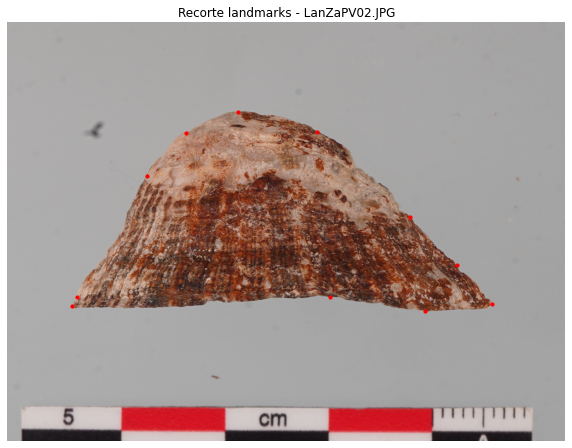

[[ 232 1018]
 [ 827  320]
 [1496 1036]
 [1738 1010]
 [ 642  395]
 [ 499  552]
 [ 250  983]
 [1157  985]
 [1610  871]
 [1445  698]
 [1110  391]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV03.JPG...


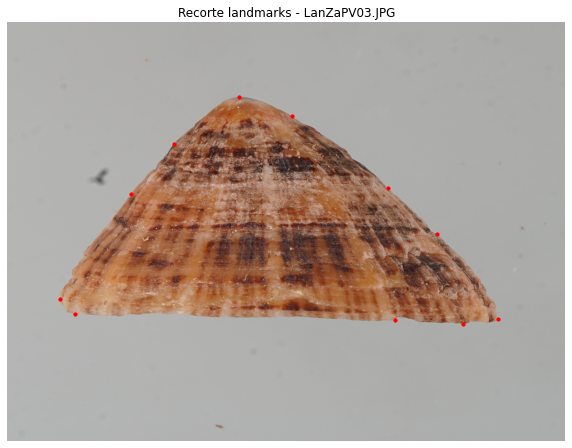

[[ 188  993]
 [ 830  268]
 [1632 1081]
 [1759 1064]
 [ 599  435]
 [ 445  615]
 [ 241 1044]
 [1388 1067]
 [1539  760]
 [1364  592]
 [1019  336]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV04.JPG...


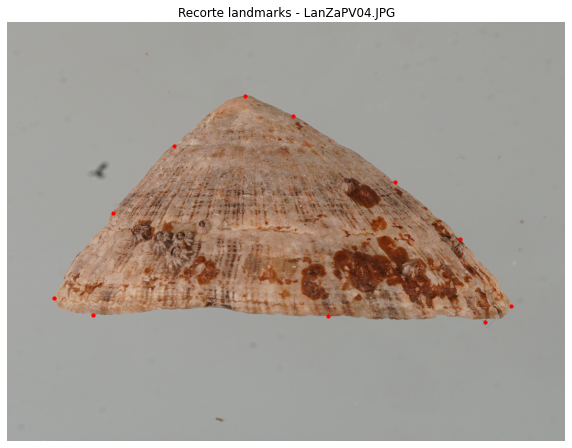

[[ 169  987]
 [ 853  264]
 [1711 1073]
 [1806 1017]
 [ 598  443]
 [ 380  682]
 [ 306 1048]
 [1151 1053]
 [1624  775]
 [1388  573]
 [1023  335]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV05.JPG...


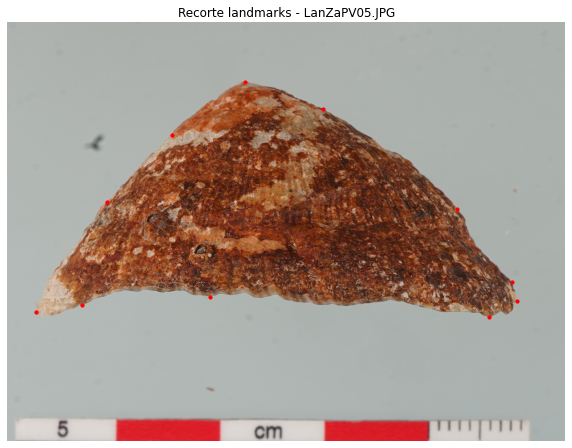

[[ 103 1037]
 [ 851  214]
 [1728 1057]
 [1825  999]
 [ 591  402]
 [ 357  644]
 [ 268 1014]
 [ 728  983]
 [1810  930]
 [1612  667]
 [1133  310]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV06.JPG...


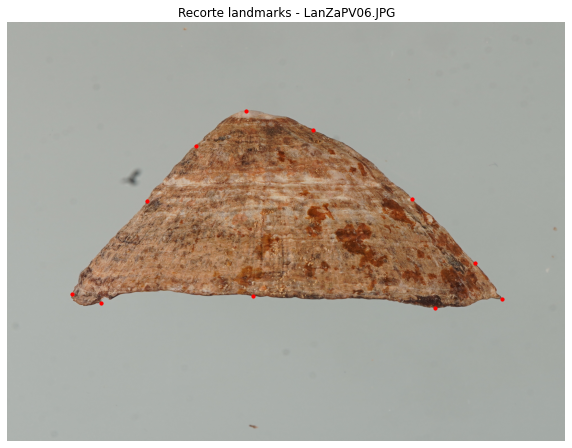

[[ 231  974]
 [ 857  316]
 [1534 1025]
 [1773  990]
 [ 675  443]
 [ 499  640]
 [ 336 1004]
 [ 879  981]
 [1676  861]
 [1450  632]
 [1097  384]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV08.JPG...


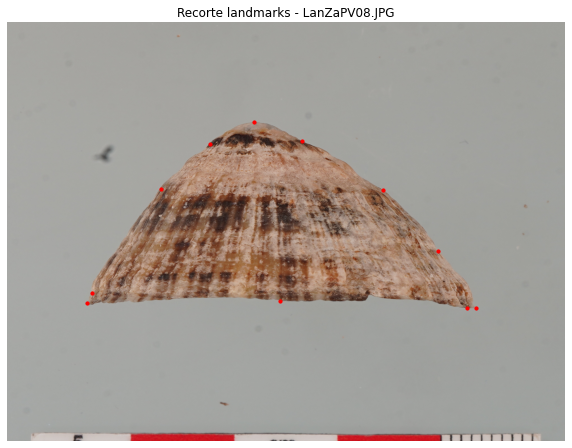

[[ 287 1005]
 [ 884  358]
 [1649 1025]
 [1680 1023]
 [ 726  437]
 [ 549  596]
 [ 302  971]
 [ 976  997]
 [1545  820]
 [1347  602]
 [1056  426]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV09.JPG...


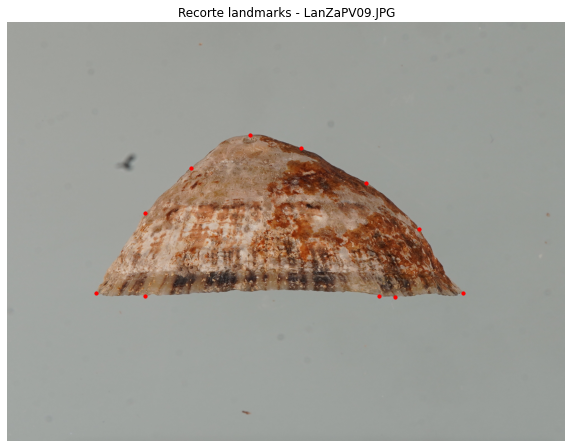

[[ 318  971]
 [ 868  404]
 [1391  985]
 [1634  969]
 [ 660  521]
 [ 495  682]
 [ 492  981]
 [1331  979]
 [1476  739]
 [1287  574]
 [1051  451]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV10.JPG...


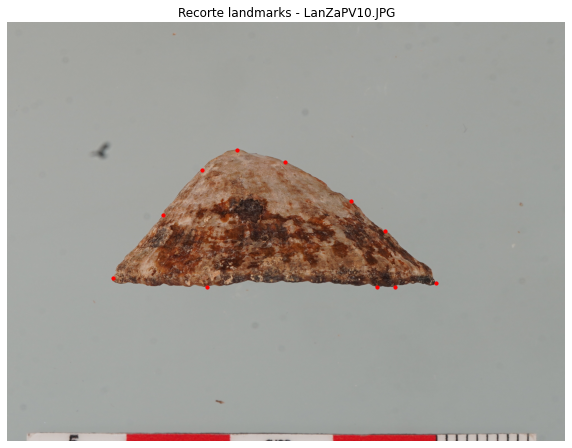

[[ 378  917]
 [ 822  456]
 [1324  949]
 [1536  935]
 [ 698  528]
 [ 559  691]
 [ 714  947]
 [1388  947]
 [1355  747]
 [1232  639]
 [ 996  501]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV11.JPG...


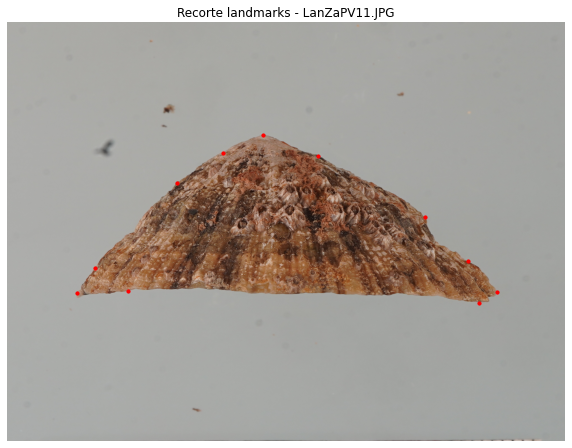

[[ 249  970]
 [ 918  403]
 [1692 1004]
 [1755  967]
 [ 774  467]
 [ 607  574]
 [ 314  880]
 [ 434  961]
 [1650  856]
 [1497  699]
 [1115  477]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV12.JPG...


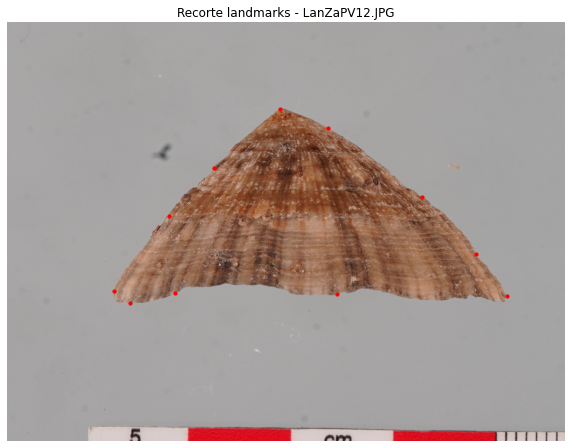

[[ 383  964]
 [ 439 1006]
 [ 979  310]
 [1791  982]
 [ 741  520]
 [ 578  692]
 [ 600  971]
 [1182  975]
 [1680  831]
 [1488  625]
 [1149  379]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV13.JPG...


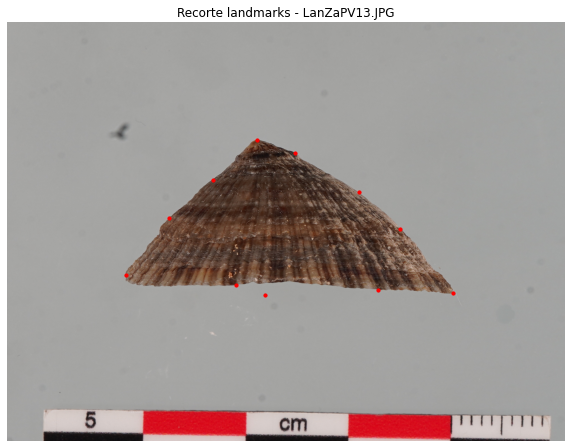

[[ 424  906]
 [ 896  422]
 [ 924  978]
 [1599  969]
 [ 736  565]
 [ 581  701]
 [ 821  942]
 [1328  958]
 [1409  740]
 [1259  608]
 [1031  467]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV14.JPG...


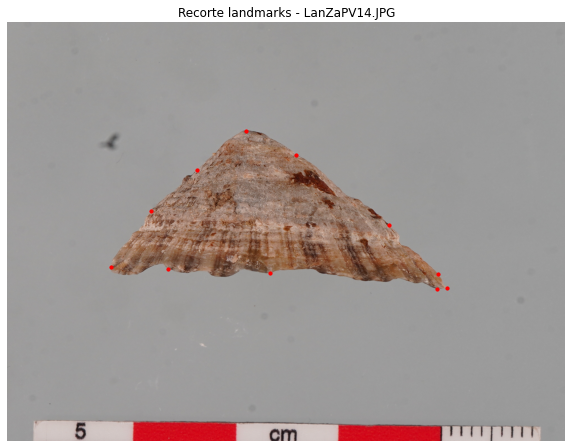

[[ 371  875]
 [ 856  388]
 [1540  956]
 [1576  952]
 [ 681  528]
 [ 514  675]
 [ 577  884]
 [ 940  899]
 [1543  901]
 [1368  725]
 [1035  474]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV15.JPG...


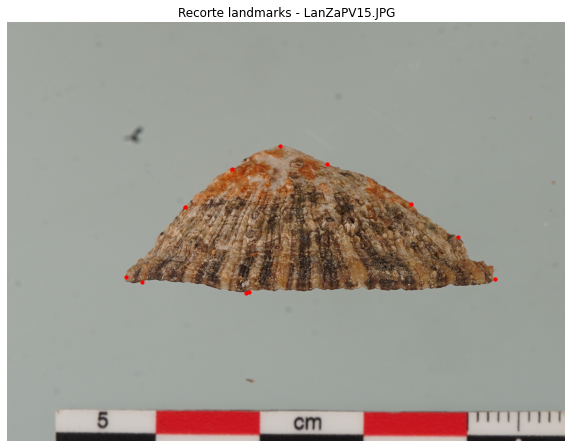

[[ 424  911]
 [ 854  969]
 [ 976  443]
 [1747  920]
 [ 805  524]
 [ 637  661]
 [ 483  929]
 [ 865  966]
 [1615  770]
 [1448  650]
 [1147  508]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV16.JPG...


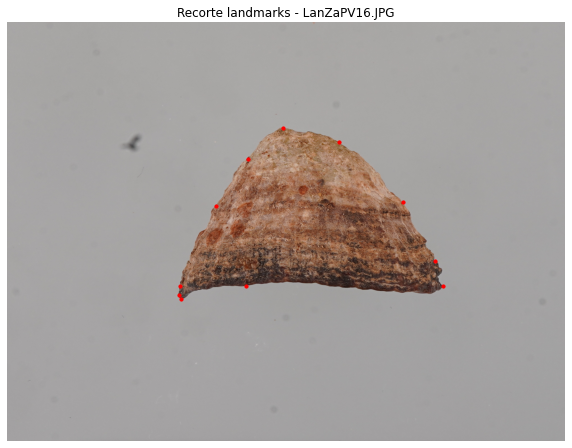

[[ 614  976]
 [ 623  991]
 [ 987  378]
 [1561  946]
 [ 862  488]
 [ 748  657]
 [ 619  945]
 [ 854  945]
 [1532  855]
 [1418  645]
 [1188  428]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV19.JPG...


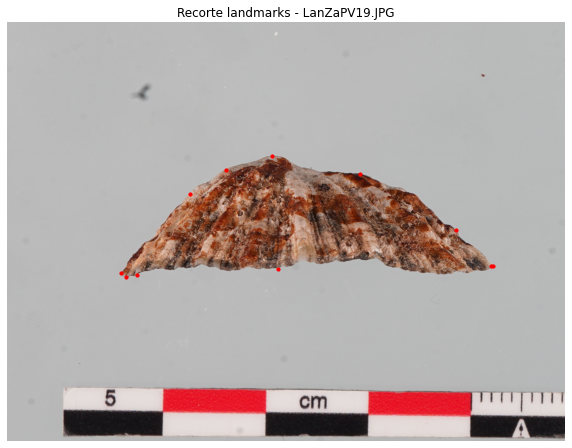

[[ 408  899]
 [ 427  913]
 [ 947  479]
 [1742  873]
 [ 784  528]
 [ 654  615]
 [ 464  907]
 [ 970  882]
 [1733  873]
 [1608  745]
 [1263  543]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV20.JPG...


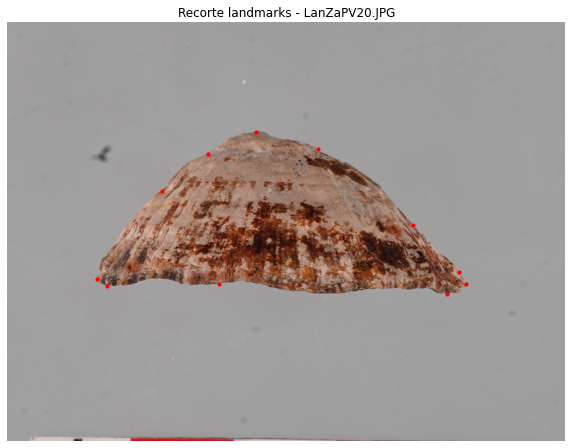

[[ 322  921]
 [ 893  392]
 [1575  973]
 [1645  939]
 [ 719  470]
 [ 554  605]
 [ 358  945]
 [ 759  936]
 [1618  893]
 [1455  726]
 [1112  453]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV21.JPG...


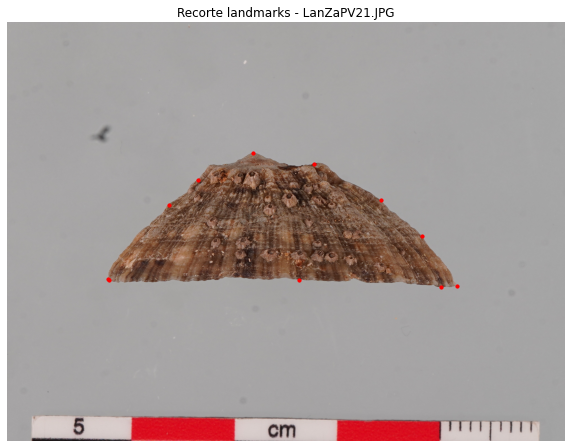

[[ 361  918]
 [ 880  469]
 [1556  950]
 [1611  943]
 [ 683  564]
 [ 579  656]
 [ 366  922]
 [1044  923]
 [1487  767]
 [1341  638]
 [1100  507]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV22.JPG...


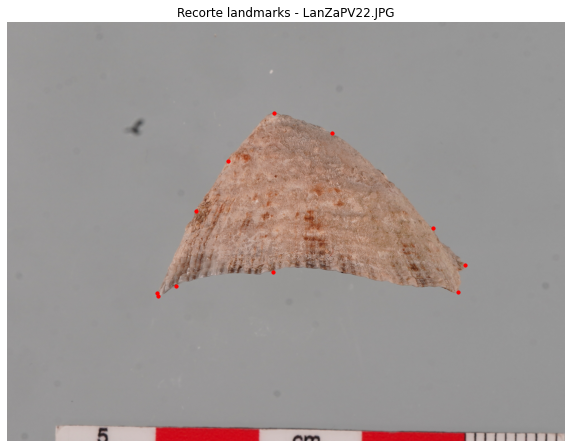

[[ 538  971]
 [ 540  979]
 [ 955  325]
 [1639  870]
 [ 792  497]
 [ 676  676]
 [ 603  944]
 [ 953  893]
 [1617  966]
 [1525  738]
 [1163  397]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV23.JPG...


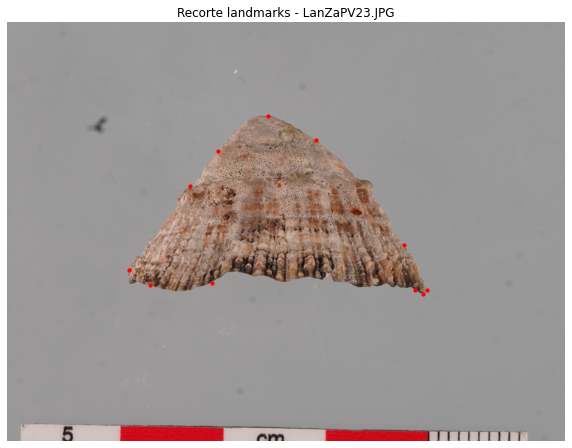

[[ 435  887]
 [ 935  335]
 [1489  973]
 [1505  960]
 [ 756  459]
 [ 653  586]
 [ 511  942]
 [ 732  933]
 [1462  959]
 [1421  797]
 [1107  422]]
Reading /storage/recol_conchas/zona_alta/lat/LanZaPV25.JPG...


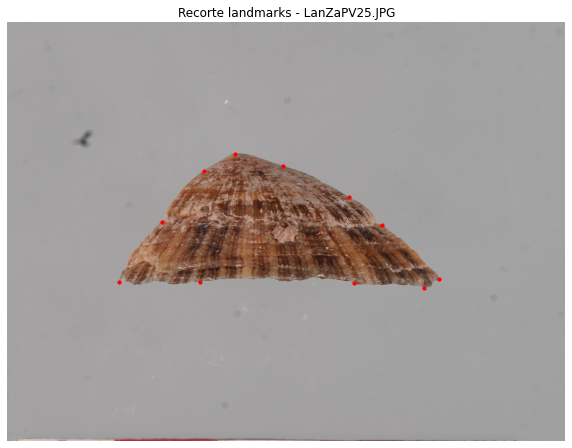

[[ 402  929]
 [ 816  471]
 [1493  951]
 [1546  918]
 [ 704  532]
 [ 553  717]
 [ 691  931]
 [1242  935]
 [1343  727]
 [1224  626]
 [ 988  515]]


In [3]:
import pandas as pd


carpeta = '/storage/recol_conchas/zona_alta/lat/'  # Cambia a la ruta de tu carpeta
patron = '.JPG'

landmarks_list = []           # Para guardar los landmarks de cada imagen
file_names = []               # Para guardar el nombre de cada imagen

# Recorrer todos los archivos en la carpeta
for archivo in os.listdir(carpeta):
    if archivo.endswith(patron):
        # Guardar los landmarks y el nombre del archivo
        landmarks_list.append(get_landmarks(carpeta, archivo, num_landmarks))
        file_names.append(archivo)
        


# Supongamos que ya tienes:
# landmarks_list: lista de arrays (cada uno de forma (N_landmarks, 2))
# file_names: lista con identificadores de cada imagen
# Si no dispones de grupo, puedes asignar un grupo por defecto o cargarlo de otra fuente.
# En este ejemplo asignamos "lamarcki" a todas las muestras.
groups = ["zona_alta"] * len(landmarks_list)

# Número de landmarks (asumiendo que todos tienen el mismo número)
N_landmarks = landmarks_list[0].shape[0]

# Crear la lista de columnas para el DataFrame
columns = ["specimen_id"]
for i in range(1, N_landmarks + 1):
    columns.extend([f"x{i}", f"y{i}"])

# Construir las filas con la información de cada espécimen
rows = []
for specimen_id, landmarks in zip(file_names, landmarks_list):
    # Convertir cada landmark (array de [x, y]) a lista
    coords = landmarks.flatten().tolist()
    row = [specimen_id] + coords
    rows.append(row)

# Crear el DataFrame
df = pd.DataFrame(rows, columns=columns)

# Guardar en CSV (sin índice)
df.to_csv(carpeta + "landmarks_data.csv", index=False)



In [4]:
N = num_landmarks

with open(carpeta + "landmarks_data_tab.csv", "w") as f:
    # Escribir la cabecera
    header = "ID" + "".join([f"\tx{i+1}\ty{i+1}" for i in range(N)])
    f.write(header + "\n")
    
    # Escribir una línea por cada espécimen
    for specimen_id, landmarks in zip(file_names, landmarks_list):
        # landmarks es un array de forma (N, 2); se formatea cada par (x,y) a 6 decimales
        coords_str = "".join([f"\t{pt[0]:.6f}\t{pt[1]:.6f}" for pt in landmarks])
        row = f"{specimen_id}{coords_str}\n"
        f.write(row)


Reading /storage/recol_conchas/zona_baja/lat/LanZbPV27.JPG...


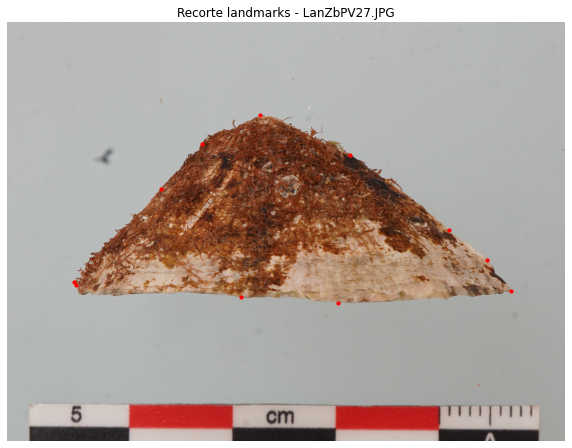

[[ 240  931]
 [ 907  332]
 [1185 1006]
 [1806  961]
 [ 698  437]
 [ 551  596]
 [ 245  941]
 [ 838  984]
 [1721  852]
 [1584  743]
 [1229  474]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV28.JPG...


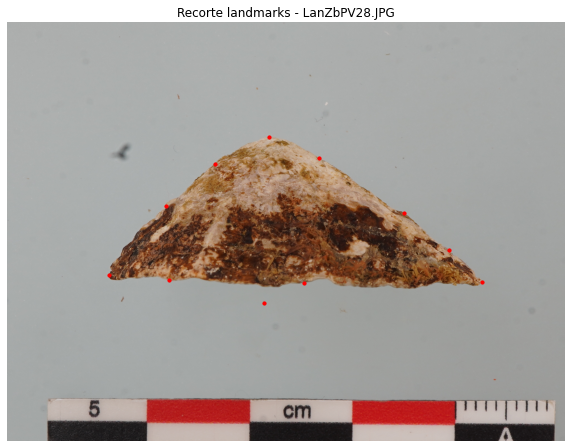

[[ 366  905]
 [ 920 1005]
 [ 938  411]
 [1702  932]
 [ 743  509]
 [ 568  657]
 [ 578  922]
 [1065  933]
 [1583  815]
 [1421  682]
 [1118  487]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV30.JPG...


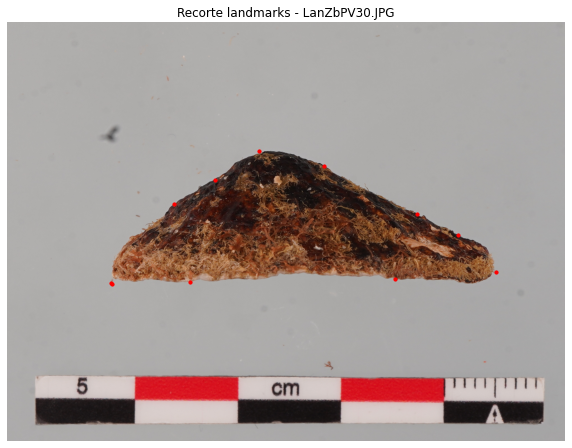

[[ 371  933]
 [ 374  938]
 [ 903  459]
 [1750  893]
 [ 746  564]
 [ 599  652]
 [ 656  931]
 [1389  921]
 [1616  761]
 [1469  686]
 [1135  514]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV32.JPG...


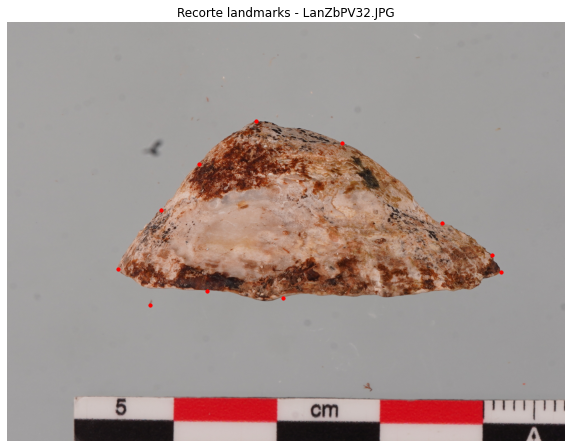

[[ 395  882]
 [ 511 1012]
 [ 890  355]
 [1768  896]
 [ 686  506]
 [ 550  672]
 [ 717  961]
 [ 989  986]
 [1737  835]
 [1559  720]
 [1199  433]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV33.JPG...


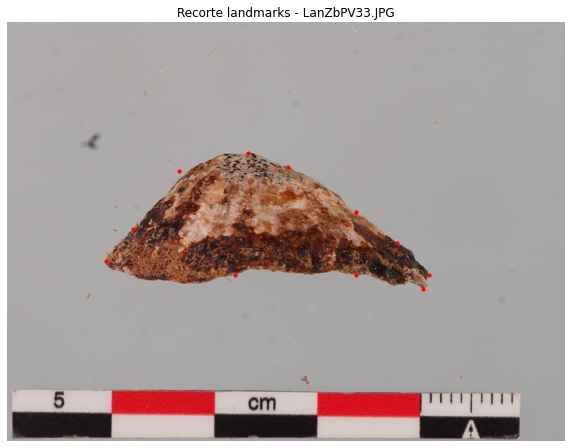

[[ 354  855]
 [ 863  468]
 [1491  955]
 [1511  904]
 [ 615  531]
 [ 452  740]
 [ 815  904]
 [1251  906]
 [1396  789]
 [1249  680]
 [1005  518]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV34.JPG...


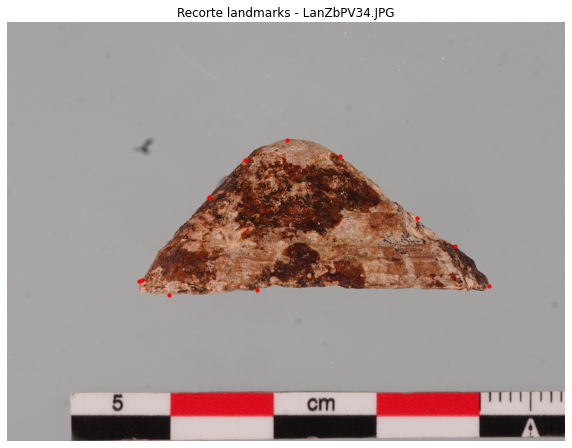

[[ 471  927]
 [ 580  978]
 [1003  420]
 [1728  946]
 [ 852  494]
 [ 722  625]
 [ 484  923]
 [ 896  958]
 [1605  802]
 [1470  701]
 [1191  480]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV35.JPG...


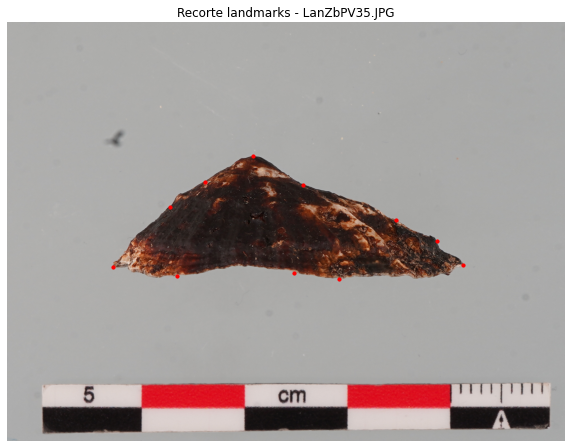

[[ 378  876]
 [ 880  480]
 [1189  919]
 [1634  868]
 [ 710  571]
 [ 583  662]
 [ 609  908]
 [1029  897]
 [1540  784]
 [1393  708]
 [1061  581]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV36.JPG...


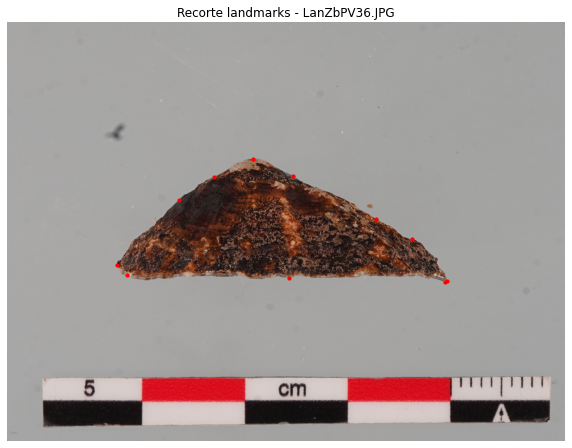

[[ 394  871]
 [ 880  489]
 [1568  931]
 [1577  925]
 [ 742  555]
 [ 616  637]
 [ 428  907]
 [1008  916]
 [1449  777]
 [1320  703]
 [1023  549]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV37.JPG...


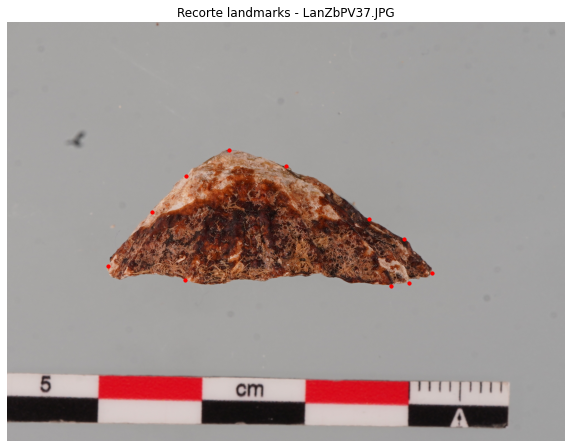

[[ 359  874]
 [ 796  458]
 [1375  945]
 [1523  897]
 [ 639  551]
 [ 517  678]
 [ 636  922]
 [1441  933]
 [1421  775]
 [1295  704]
 [1000  516]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV38.JPG...


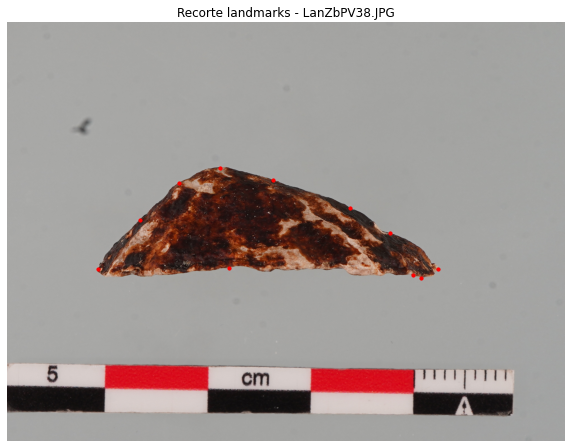

[[ 325  884]
 [ 762  520]
 [1484  915]
 [1545  882]
 [ 617  576]
 [ 475  709]
 [ 794  880]
 [1454  907]
 [1370  755]
 [1228  665]
 [ 951  565]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV39.JPG...


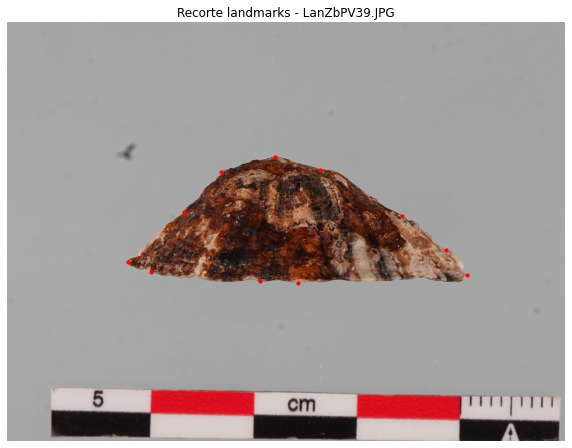

[[ 431  858]
 [ 958  482]
 [1041  934]
 [1646  905]
 [ 765  536]
 [ 634  679]
 [ 514  895]
 [ 907  928]
 [1572  814]
 [1416  692]
 [1122  528]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV40.JPG...


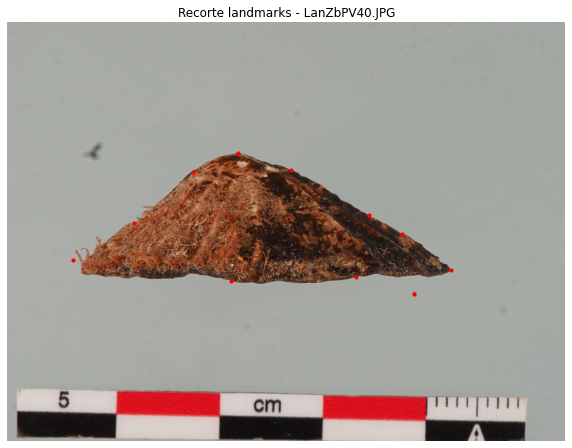

[[ 236  851]
 [ 825  469]
 [1459  973]
 [1590  888]
 [ 664  535]
 [ 455  718]
 [ 800  925]
 [1250  913]
 [1415  757]
 [1296  691]
 [1017  530]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV41.JPG...


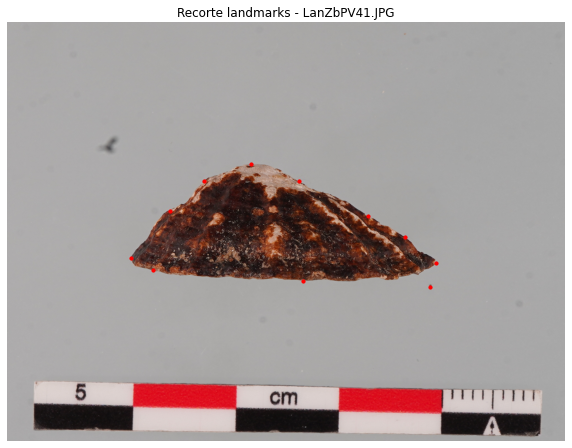

[[ 445  843]
 [ 874  508]
 [1516  947]
 [1537  863]
 [ 704  570]
 [ 583  675]
 [ 522  889]
 [1059  926]
 [1426  770]
 [1292  695]
 [1044  569]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV42.JPG...


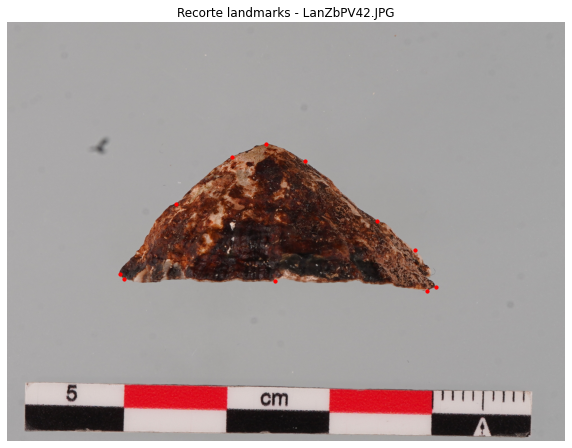

[[ 403  901]
 [ 926  437]
 [1503  964]
 [1536  948]
 [ 805  484]
 [ 603  651]
 [ 417  918]
 [ 959  928]
 [1460  816]
 [1326  710]
 [1066  497]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV43.JPG...


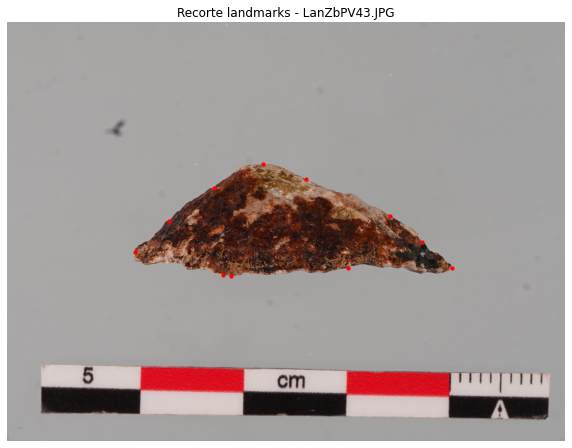

[[ 456  823]
 [ 800  909]
 [ 917  509]
 [1593  879]
 [ 741  592]
 [ 579  711]
 [ 773  904]
 [1220  881]
 [1486  787]
 [1372  694]
 [1072  562]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV44.JPG...


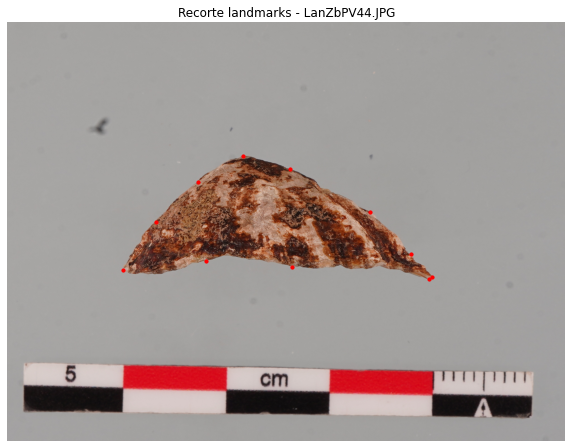

[[ 415  886]
 [ 845  480]
 [1513  921]
 [1523  911]
 [ 683  572]
 [ 532  715]
 [ 711  854]
 [1022  875]
 [1448  831]
 [1301  681]
 [1013  527]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV45.JPG...


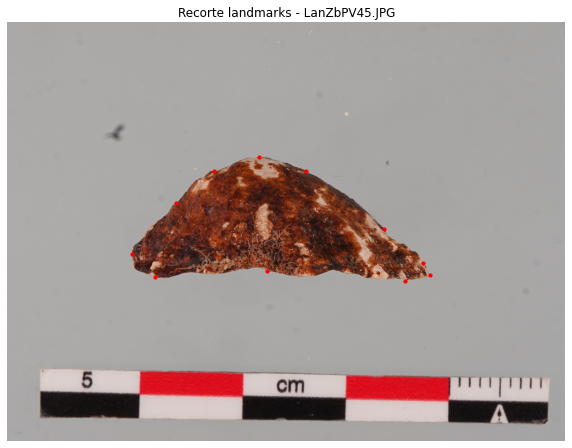

[[ 446  830]
 [ 901  484]
 [1427  925]
 [1515  906]
 [ 739  533]
 [ 606  648]
 [ 530  912]
 [ 931  890]
 [1490  862]
 [1351  739]
 [1069  531]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV46.JPG...


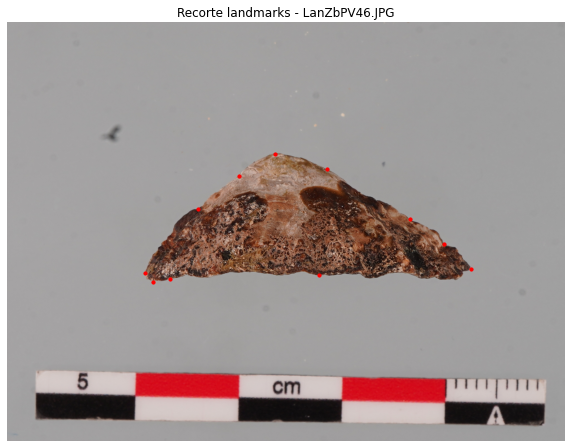

[[ 494  899]
 [ 523  929]
 [ 959  470]
 [1661  882]
 [ 829  551]
 [ 684  669]
 [ 583  919]
 [1117  907]
 [1566  793]
 [1443  705]
 [1144  527]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV47.JPG...


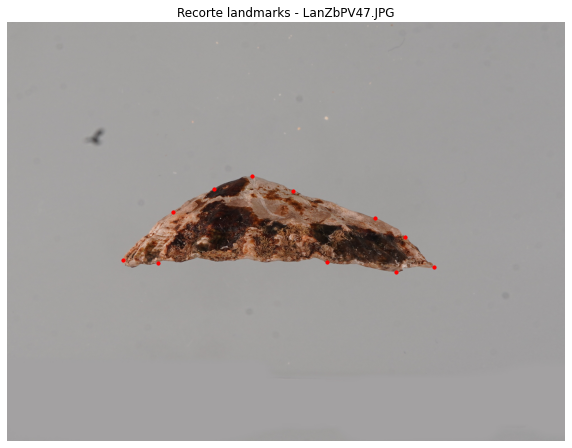

[[ 416  853]
 [ 878  552]
 [1394  895]
 [1528  875]
 [ 740  598]
 [ 595  680]
 [ 539  863]
 [1146  860]
 [1425  769]
 [1318  702]
 [1025  603]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV48.JPG...


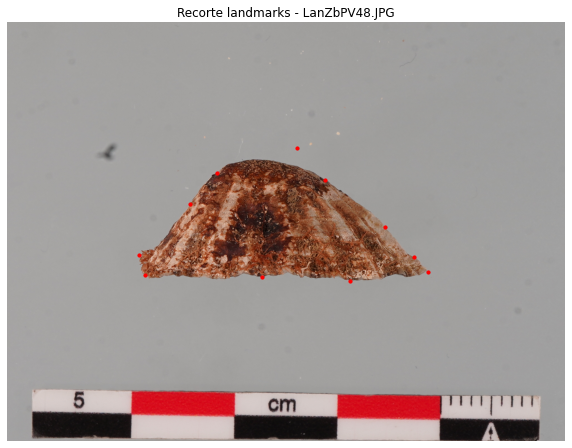

[[ 471  835]
 [1038  451]
 [1228  925]
 [1506  893]
 [ 753  540]
 [ 656  652]
 [ 494  905]
 [ 911  913]
 [1458  841]
 [1353  733]
 [1137  563]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV49.JPG...


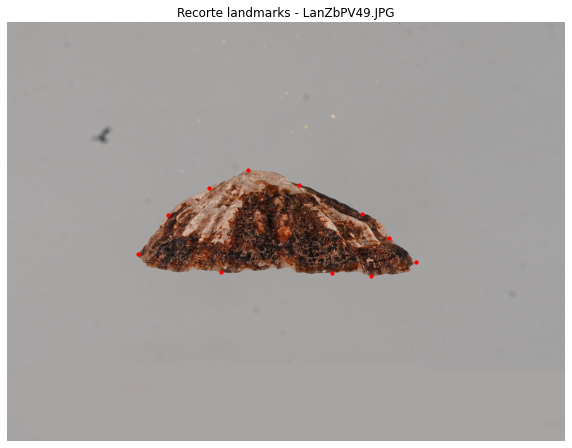

[[ 470  831]
 [ 862  529]
 [1302  910]
 [1463  860]
 [ 722  595]
 [ 577  690]
 [ 765  896]
 [1164  897]
 [1368  774]
 [1271  688]
 [1046  583]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV50.JPG...


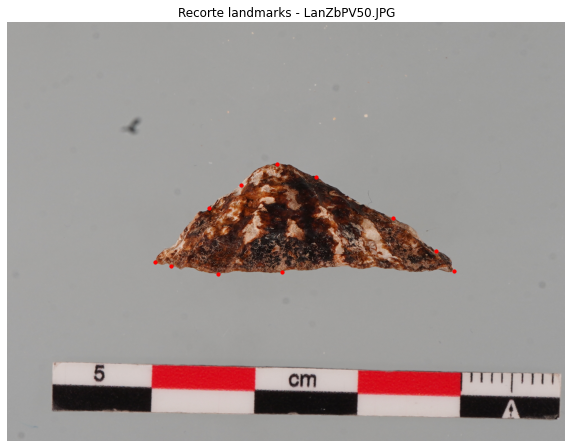

[[ 529  858]
 [ 755  902]
 [ 965  507]
 [1602  890]
 [ 836  584]
 [ 724  666]
 [ 585  874]
 [ 984  896]
 [1537  819]
 [1382  701]
 [1107  553]]


In [5]:
carpeta = '/storage/recol_conchas/zona_baja/lat/'  # Cambia a la ruta de tu carpeta
patron = '.JPG'

landmarks_list = []           # Para guardar los landmarks de cada imagen
file_names = []               # Para guardar el nombre de cada imagen

# Recorrer todos los archivos en la carpeta
for archivo in os.listdir(carpeta):
    if archivo.endswith(patron):
        # Guardar los landmarks y el nombre del archivo
        landmarks_list.append(get_landmarks(carpeta, archivo, num_landmarks))
        file_names.append(archivo)

N = num_landmarks

# Crear la lista de columnas para el DataFrame
columns = ["specimen_id"]
for i in range(1, N_landmarks + 1):
    columns.extend([f"x{i}", f"y{i}"])

# Construir las filas con la información de cada espécimen
rows = []
for specimen_id, landmarks in zip(file_names, landmarks_list):
    # Convertir cada landmark (array de [x, y]) a lista
    coords = landmarks.flatten().tolist()
    row = [specimen_id] + coords
    rows.append(row)

# Crear el DataFrame
df = pd.DataFrame(rows, columns=columns)

# Guardar en CSV (sin índice)
df.to_csv(carpeta + "landmarks_data.csv", index=False)

with open(carpeta + "landmarks_data_tab.csv", "w") as f:
    # Escribir la cabecera
    header = "ID" + "".join([f"\tx{i+1}\ty{i+1}" for i in range(N)])
    f.write(header + "\n")
    
    # Escribir una línea por cada espécimen
    for specimen_id, landmarks in zip(file_names, landmarks_list):
        # landmarks es un array de forma (N, 2); se formatea cada par (x,y) a 6 decimales
        coords_str = "".join([f"\t{pt[0]:.6f}\t{pt[1]:.6f}" for pt in landmarks])
        row = f"{specimen_id}{coords_str}\n"
        f.write(row)


In [6]:
df

,specimen_id,x1,y1,x2,y2,x3,y3,x4,y4,x5,...,x7,y7,x8,y8,x9,y9,x10,y10,x11,y11
0,LanZbPV27.JPG,0,75,667,674,945,0,1566,45,458,...,5,65,598,22,1481,154,1344,263,989,532
1,LanZbPV28.JPG,0,100,554,0,572,594,1336,73,377,...,212,83,699,72,1217,190,1055,323,752,518
2,LanZbPV30.JPG,0,5,3,0,532,479,1379,45,375,...,285,7,1018,17,1245,177,1098,252,764,424
3,LanZbPV32.JPG,0,130,116,0,495,657,1373,116,291,...,322,51,594,26,1342,177,1164,292,804,579
4,LanZbPV33.JPG,0,100,509,487,1137,0,1157,51,261,...,461,51,897,49,1042,166,895,275,651,437
5,LanZbPV34.JPG,0,51,109,0,532,558,1257,32,381,...,13,55,425,20,1134,176,999,277,720,498
6,LanZbPV35.JPG,0,43,502,439,811,0,1256,51,332,...,231,11,651,22,1162,135,1015,211,683,338
7,LanZbPV36.JPG,0,60,486,442,1174,0,1183,6,348,...,34,24,614,15,1055,154,926,228,629,382
8,LanZbPV37.JPG,0,71,437,487,1016,0,1164,48,280,...,277,23,1082,12,1062,170,936,241,641,429
9,LanZbPV38.JPG,0,31,437,395,1159,0,1220,33,292,...,469,35,1129,8,1045,160,903,250,626,350


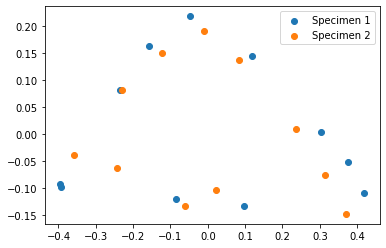

In [7]:
import numpy as np
from scipy.spatial import procrustes
import matplotlib.pyplot as plt

# Aplicar GPA utilizando la función de Procrustes en SciPy
def generalized_procrustes(ref, target):
    mtx1, mtx2, disparity = procrustes(ref, target)
    return mtx1, mtx2, disparity

specimen1 = landmarks_list[0]
specimen2 = landmarks_list[1]

# Realizar GPA
aligned1, aligned2, _ = generalized_procrustes(specimen1, specimen2)

# Visualizar la comparación
plt.scatter(aligned1[:, 0], aligned1[:, 1], label='Specimen 1')
plt.scatter(aligned2[:, 0], aligned2[:, 1], label='Specimen 2')
plt.legend()
plt.show()

Reading /storage/recol_conchas/zona_baja/lat/LanZbPV27.JPG...


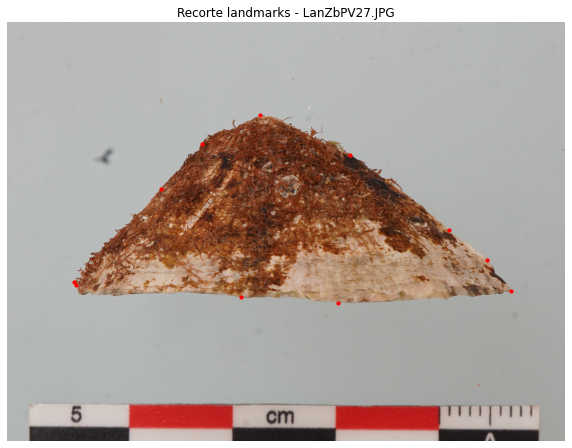

[[ 240  931]
 [ 907  332]
 [1185 1006]
 [1806  961]
 [ 698  437]
 [ 551  596]
 [ 245  941]
 [ 838  984]
 [1721  852]
 [1584  743]
 [1229  474]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV28.JPG...


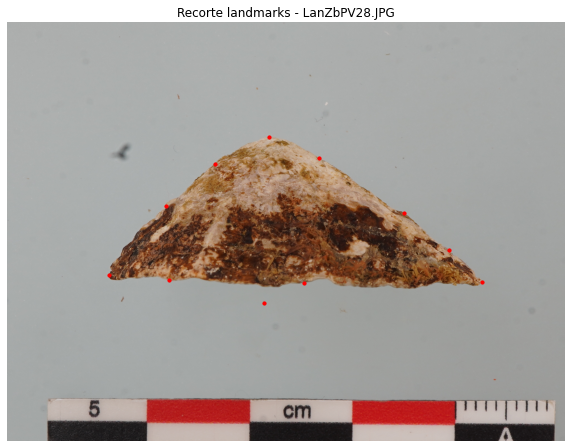

[[ 366  905]
 [ 920 1005]
 [ 938  411]
 [1702  932]
 [ 743  509]
 [ 568  657]
 [ 578  922]
 [1065  933]
 [1583  815]
 [1421  682]
 [1118  487]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV30.JPG...


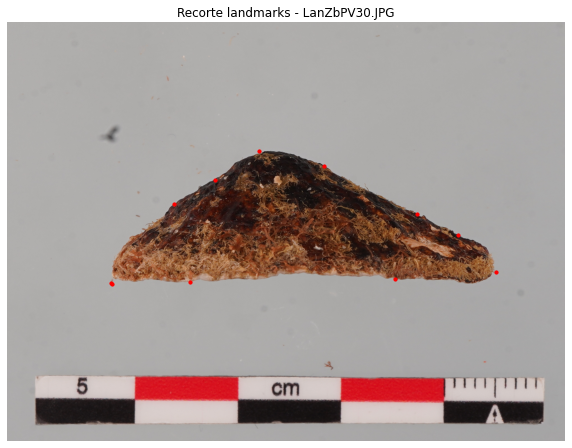

[[ 371  933]
 [ 374  938]
 [ 903  459]
 [1750  893]
 [ 746  564]
 [ 599  652]
 [ 656  931]
 [1389  921]
 [1616  761]
 [1469  686]
 [1135  514]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV32.JPG...


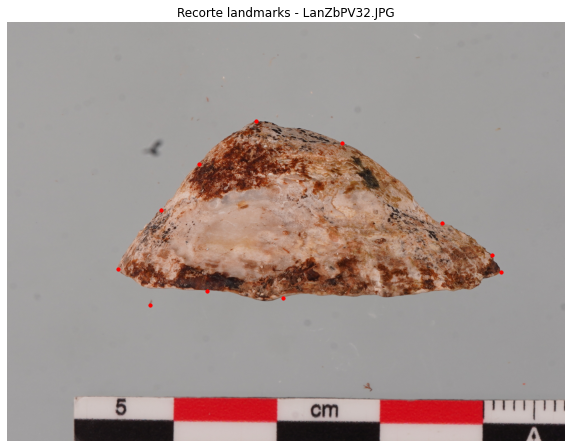

[[ 395  882]
 [ 511 1012]
 [ 890  355]
 [1768  896]
 [ 686  506]
 [ 550  672]
 [ 717  961]
 [ 989  986]
 [1737  835]
 [1559  720]
 [1199  433]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV33.JPG...


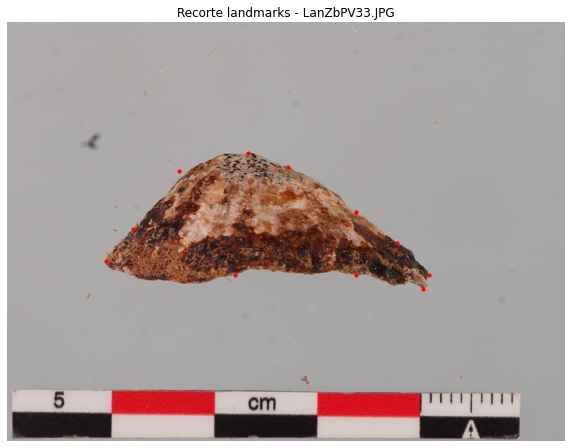

[[ 354  855]
 [ 863  468]
 [1491  955]
 [1511  904]
 [ 615  531]
 [ 452  740]
 [ 815  904]
 [1251  906]
 [1396  789]
 [1249  680]
 [1005  518]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV34.JPG...


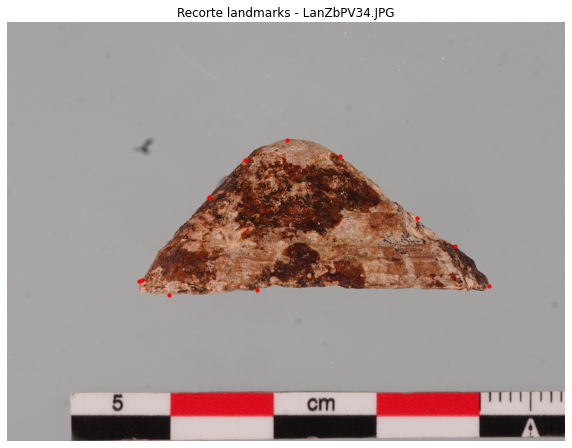

[[ 471  927]
 [ 580  978]
 [1003  420]
 [1728  946]
 [ 852  494]
 [ 722  625]
 [ 484  923]
 [ 896  958]
 [1605  802]
 [1470  701]
 [1191  480]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV35.JPG...


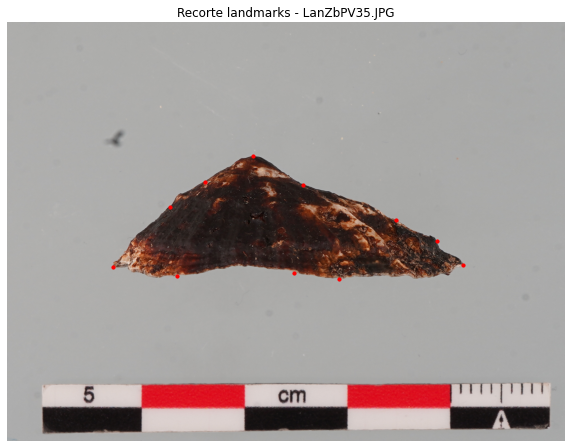

[[ 378  876]
 [ 880  480]
 [1189  919]
 [1634  868]
 [ 710  571]
 [ 583  662]
 [ 609  908]
 [1029  897]
 [1540  784]
 [1393  708]
 [1061  581]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV36.JPG...


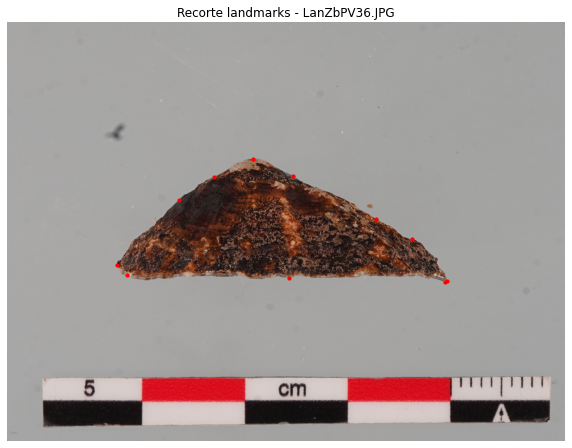

[[ 394  871]
 [ 880  489]
 [1568  931]
 [1577  925]
 [ 742  555]
 [ 616  637]
 [ 428  907]
 [1008  916]
 [1449  777]
 [1320  703]
 [1023  549]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV37.JPG...


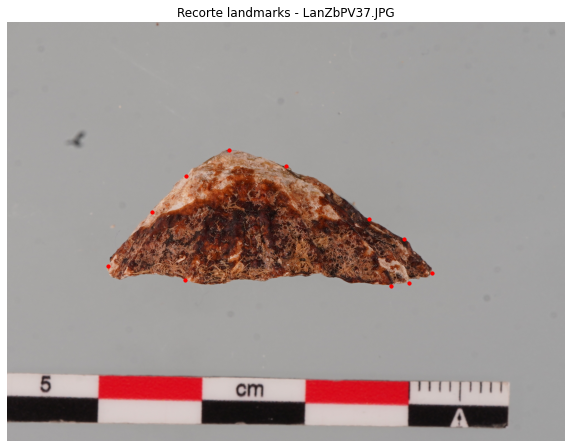

[[ 359  874]
 [ 796  458]
 [1375  945]
 [1523  897]
 [ 639  551]
 [ 517  678]
 [ 636  922]
 [1441  933]
 [1421  775]
 [1295  704]
 [1000  516]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV38.JPG...


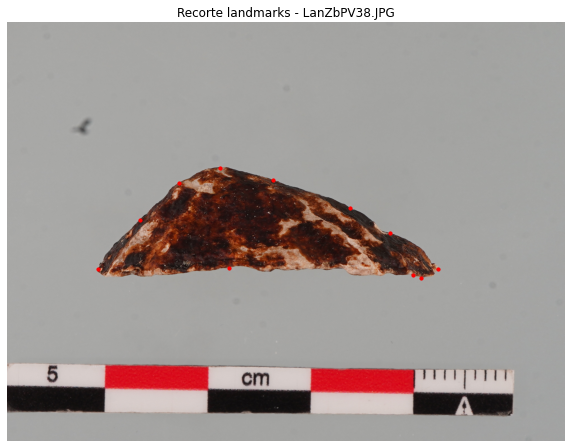

[[ 325  884]
 [ 762  520]
 [1484  915]
 [1545  882]
 [ 617  576]
 [ 475  709]
 [ 794  880]
 [1454  907]
 [1370  755]
 [1228  665]
 [ 951  565]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV39.JPG...


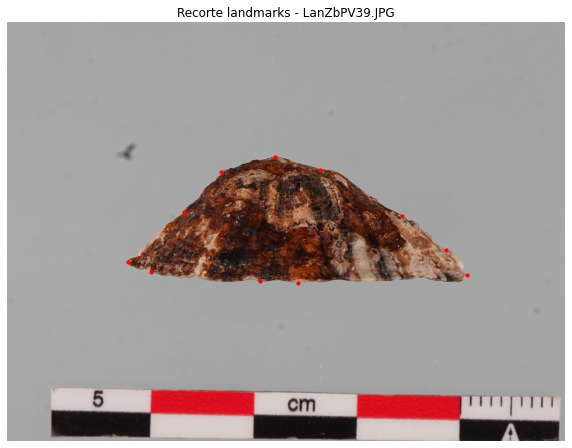

[[ 431  858]
 [ 958  482]
 [1041  934]
 [1646  905]
 [ 765  536]
 [ 634  679]
 [ 514  895]
 [ 907  928]
 [1572  814]
 [1416  692]
 [1122  528]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV40.JPG...


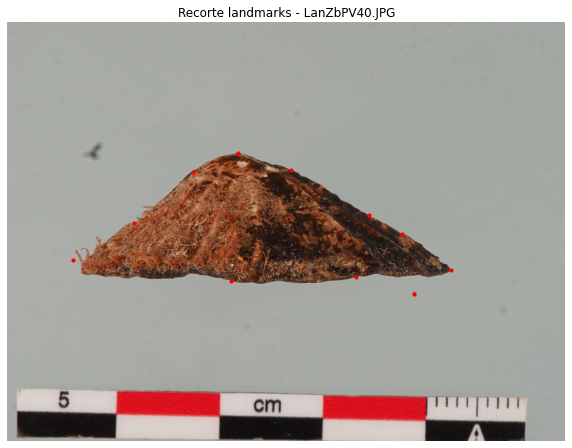

[[ 236  851]
 [ 825  469]
 [1459  973]
 [1590  888]
 [ 664  535]
 [ 455  718]
 [ 800  925]
 [1250  913]
 [1415  757]
 [1296  691]
 [1017  530]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV41.JPG...


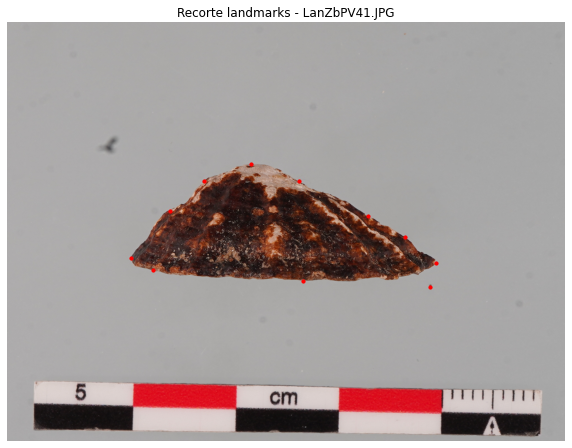

[[ 445  843]
 [ 874  508]
 [1516  947]
 [1537  863]
 [ 704  570]
 [ 583  675]
 [ 522  889]
 [1059  926]
 [1426  770]
 [1292  695]
 [1044  569]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV42.JPG...


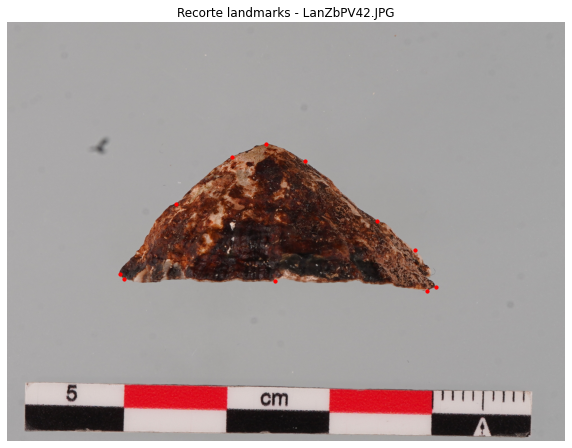

[[ 403  901]
 [ 926  437]
 [1503  964]
 [1536  948]
 [ 805  484]
 [ 603  651]
 [ 417  918]
 [ 959  928]
 [1460  816]
 [1326  710]
 [1066  497]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV43.JPG...


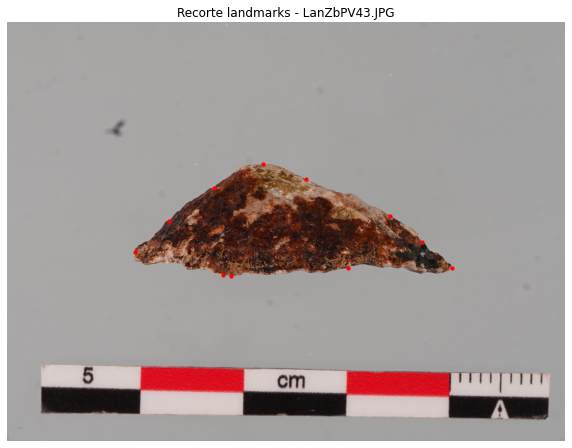

[[ 456  823]
 [ 800  909]
 [ 917  509]
 [1593  879]
 [ 741  592]
 [ 579  711]
 [ 773  904]
 [1220  881]
 [1486  787]
 [1372  694]
 [1072  562]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV44.JPG...


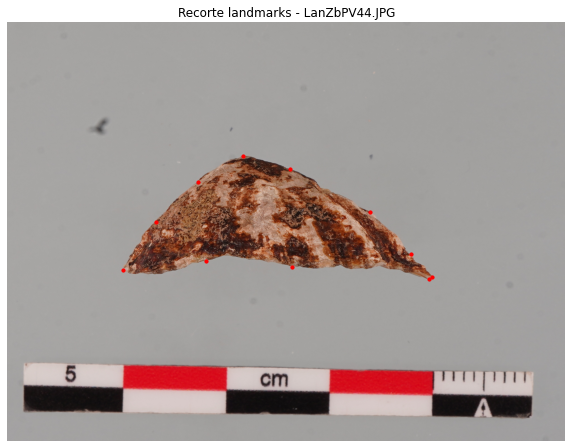

[[ 415  886]
 [ 845  480]
 [1513  921]
 [1523  911]
 [ 683  572]
 [ 532  715]
 [ 711  854]
 [1022  875]
 [1448  831]
 [1301  681]
 [1013  527]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV45.JPG...


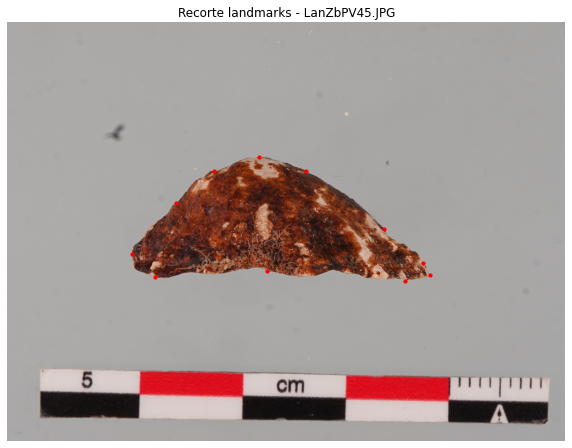

[[ 446  830]
 [ 901  484]
 [1427  925]
 [1515  906]
 [ 739  533]
 [ 606  648]
 [ 530  912]
 [ 931  890]
 [1490  862]
 [1351  739]
 [1069  531]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV46.JPG...


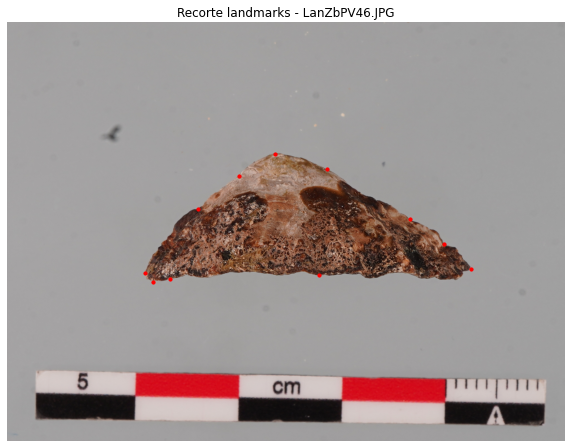

[[ 494  899]
 [ 523  929]
 [ 959  470]
 [1661  882]
 [ 829  551]
 [ 684  669]
 [ 583  919]
 [1117  907]
 [1566  793]
 [1443  705]
 [1144  527]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV47.JPG...


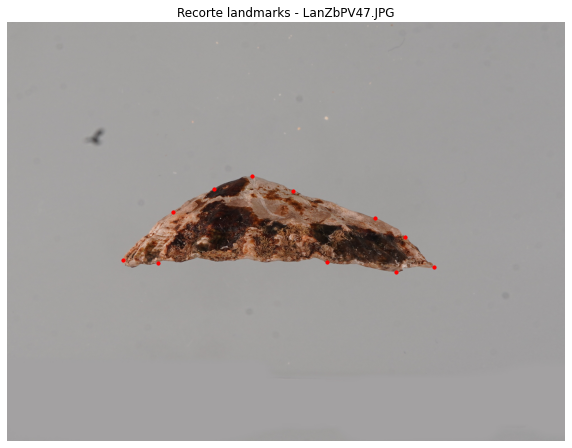

[[ 416  853]
 [ 878  552]
 [1394  895]
 [1528  875]
 [ 740  598]
 [ 595  680]
 [ 539  863]
 [1146  860]
 [1425  769]
 [1318  702]
 [1025  603]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV48.JPG...


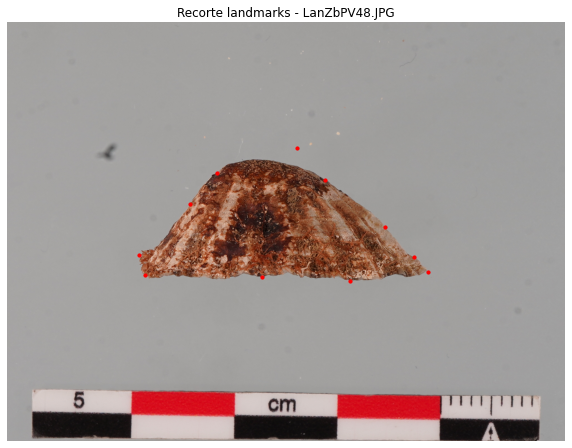

[[ 471  835]
 [1038  451]
 [1228  925]
 [1506  893]
 [ 753  540]
 [ 656  652]
 [ 494  905]
 [ 911  913]
 [1458  841]
 [1353  733]
 [1137  563]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV49.JPG...


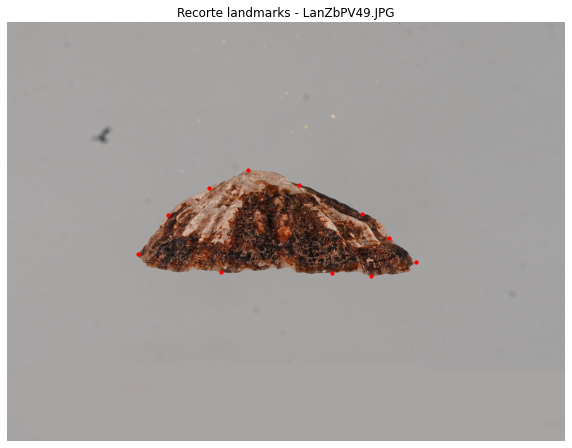

[[ 470  831]
 [ 862  529]
 [1302  910]
 [1463  860]
 [ 722  595]
 [ 577  690]
 [ 765  896]
 [1164  897]
 [1368  774]
 [1271  688]
 [1046  583]]
Reading /storage/recol_conchas/zona_baja/lat/LanZbPV50.JPG...


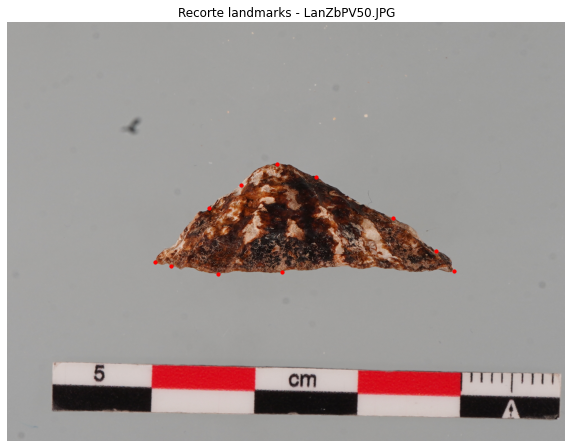

[[ 529  858]
 [ 755  902]
 [ 965  507]
 [1602  890]
 [ 836  584]
 [ 724  666]
 [ 585  874]
 [ 984  896]
 [1537  819]
 [1382  701]
 [1107  553]]


In [8]:
carpeta = '/storage/recol_conchas/zona_baja/lat/'  # Cambia a la ruta de tu carpeta
patron = '.JPG'

landmarks_list = []           # Para guardar los landmarks de cada imagen
file_names = []               # Para guardar el nombre de cada imagen

# Recorrer todos los archivos en la carpeta
for archivo in os.listdir(carpeta):
    if archivo.endswith(patron):
        # Guardar los landmarks y el nombre del archivo
        landmarks_list.append(get_landmarks(carpeta, archivo, num_landmarks))
        file_names.append(archivo)


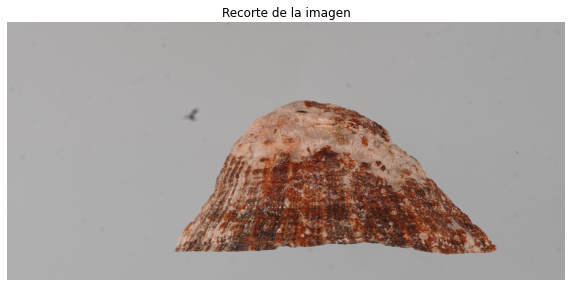

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Cargar la imagen (asegúrate de usar la ruta correcta)
imagen = cv2.imread("/storage/recol_conchas/zona_alta/lat/LanZaPV02.JPG")
if imagen is None:
    raise Exception("No se pudo cargar la imagen.")

# Para mostrar con matplotlib es conveniente convertir de BGR a RGB
imagen_rgb = cv2.cvtColor(imagen, cv2.COLOR_BGR2RGB)

# Definir las coordenadas del recorte:
# (x1, y1) = (1500,1500) y (x2, y2) = (4100,2700)
x1, y1 = 1500, 1500
x2, y2 = 4100, 2700

# Recortar la imagen: recuerda que la primera dimensión es y (filas) y la segunda es x (columnas)
roi = imagen_rgb[y1:y2, x1:x2]

# Mostrar la región recortada usando matplotlib
plt.figure(figsize=(10, 8))
plt.imshow(roi)
plt.axis('off')
plt.title("Recorte de la imagen")
plt.show()

# Alternativamente, si prefieres usar OpenCV para mostrar la imagen:
cv2.imshow("Recorte", cv2.cvtColor(roi, cv2.COLOR_RGB2BGR))
cv2.waitKey(0)
cv2.destroyAllWindows()



In [ ]:
!pip install ipympl
